# Humming noise detection

## Humming noise
Low frequency hums are typically caused by poor electrical isolation on the recording/copying equipment. Usually, they correspond to the frequency of the powerline (50 or 60Hz).

## Creating synthetic hums
To simulate this phenomenon, we will add a synthetic 50Hz sinusoid plus some harmonics to a clean audio signal:

In [1]:
from IPython.display import Audio
from essentia import Pool, db2amp
from essentia.standard import (
    Windowing,
    Spectrum,
    FrameGenerator,
    MonoLoader,
    Clipper,
    HumDetector
)

import numpy as np
import matplotlib.pyplot as plt

plt.rcParams["figure.figsize"] = (12, 9)

EPS = np.finfo(np.float32).eps

In [2]:
def spectrogram(audio, frame_size=2048, hop_size=512):
    """
    Auxiliary function to compute spectrograms.
    """

    window = Windowing(size=frame_size)
    spectrum = Spectrum(size=frame_size)
    pool = Pool()
    for frame in FrameGenerator(audio,
                                frameSize=frame_size,
                                hopSize=hop_size):
        pool.add("logspectrogram", spectrum(window(frame)))

    return 10 * np.log10(pool["logspectrogram"].T + EPS)

In [3]:
audio_file = "audio/Vivaldi_Sonata_5_II_Allegro.wav"
audio = MonoLoader(filename=audio_file)()

sr = 44100

# Generate a 50Hz tone.
time = np.arange(len(audio)) / sr
freq = 50
hum = np.sin(2 * np.pi * freq * time).astype(np.float32)

# Add odd harmonics via clipping.
hum = Clipper(min=-0.5, max=0.5)(hum)

# Attenuate the hum 30 dB.
hum *= db2amp(-30)

audio_with_hum = audio + hum

Now we can plot the spectrograms of the clean and altered versions and visualize the difference.
We will plot only the 50 first bins of the spectrum to focus on the frequencies around the hum:

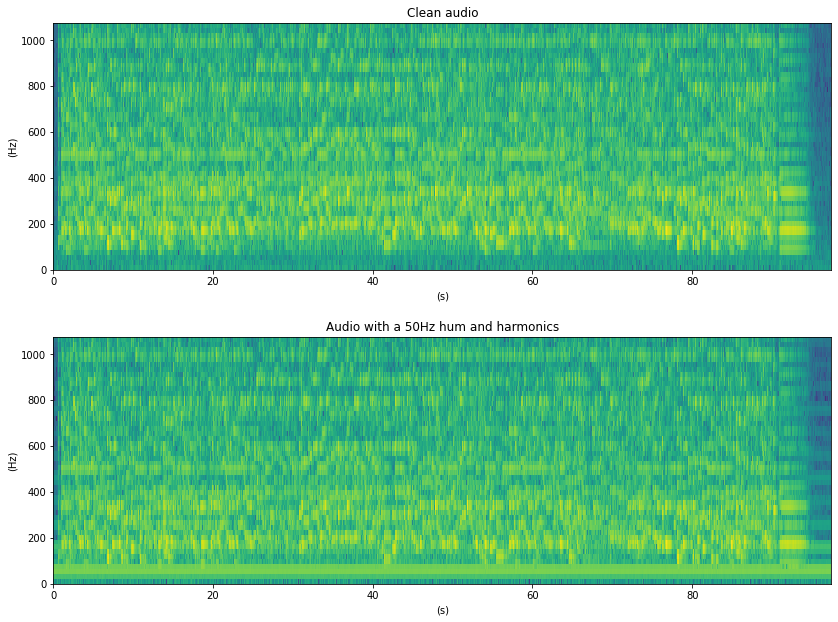

In [4]:
# Plot the first 50 FFT bins only.
max_bin = 50
spectrum_bin_freq = max_bin / 1025

f, ax = plt.subplots(2)
for i, (a, t) in enumerate([(audio, "Clean audio"),
                            (audio_with_hum, "Audio with a 50Hz hum and harmonics")]):
    ax[i].matshow(
        spectrogram(a)[:max_bin, :],
        aspect="auto",
        origin="lower",
        extent=[0, time[-1], 0, spectrum_bin_freq * sr / 2]
    )
    ax[i].set_xlabel("(s)")
    ax[i].set_ylabel("(Hz)")
    ax[i].set_title(t)
    ax[i].xaxis.set_ticks_position("bottom")
f.tight_layout(pad=2.0)

Now we can listen to the original audio:

In [5]:
Audio(audio, rate=sr)

and to the degraded version:

In [6]:
Audio(audio_with_hum, rate=sr)

## Detecting hums
[HumDetector](https://essentia.upf.edu/reference/std_HumDetector.html) relies on the assumption that the energy of the hums tends to be very stable on time.
The algorithm measures the Power Spectral Density (PSD) of the signal along time for each frequency bin.
Then, it computes the ratios between PSD quantiles on a long `time_window` to measure the stability of the frequency bins creating the quantile ratio matrix (`r`) [1].
After this, [PitchContours](https://essentia.upf.edu/reference/std_PitchContours.html) is used to track the hums on `r` allowing small frequency fluctuations [2][3].

Notice that hums can only be detected after the first `time_window` seconds, as it is the time required to start computing `r`.
The following plot shows `r` and the detected hums on top (red horizontal lines):

Detected a hum at 49.64Hz with salience 0.91 starting at 5.40s and ending at 98.00s


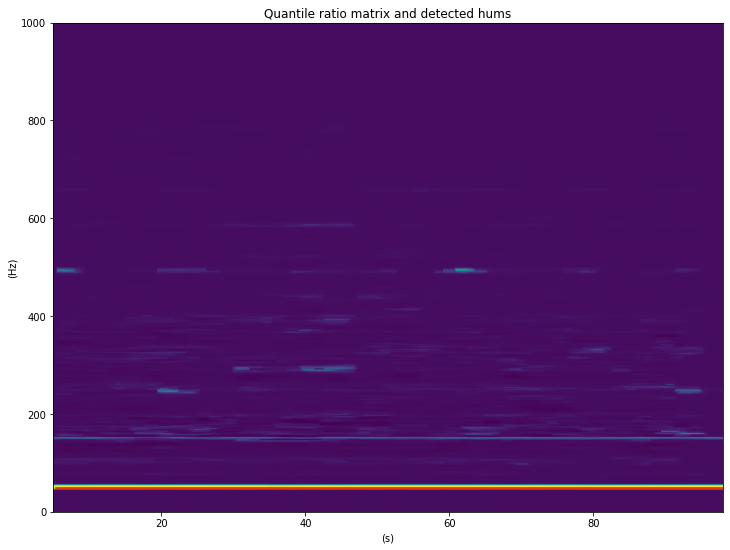

In [7]:
time_window = 5
r0, freqs, saliences, starts, ends = HumDetector(timeWindow=time_window)(audio_with_hum)

xmin = time_window
xmax = time_window + r0.shape[1] * .2
ymin = 0
ymax = 1000  # The algorithm only searches up to 1kHz.

f, ax = plt.subplots(1)
ax.matshow(
    r0,
    aspect="auto",
    origin="lower",
    extent=[xmin, xmax, ymin, ymax]
)
plt.xlabel("(s)")
plt.ylabel("(Hz)")
ax.xaxis.set_ticks_position("bottom")

# Plot the detected tones as horizontal red lines
for i in range(len(freqs)):
    plt.axhline(
        y=freqs[i],
        xmin=(starts[i] - xmin) / xmax,
        xmax=ends[i] / xmax,
        color="r"
    )

    print(
        "Detected a hum at {:.2f}Hz with salience {:.2f} starting at {:.2f}s and ending at {:.2f}s"\
            .format(freqs[i], saliences[i], starts[i], ends[i]
        )
    )

plt.title("Quantile ratio matrix and detected hums")
plt.show()

## References
[1] Brandt, M., & Bitzer, J. (2014). Automatic Detection of Hum in Audio Signals. Journal of the Audio Engineering Society, 62(9), 584-595.

[2] J. Salamon and E. Gómez, Melody extraction from polyphonic music signals using pitch contour characteristics, IEEE Transactions on Audio, Speech, and Language Processing, vol. 20, no. 6, pp. 1759–1770, 2012.

[3] The Essentia library, http://essentia.upf.edu/documentation/reference/streaming_PitchContours.html